# Training a model to predict FMA genre from features

**Problem:** We have features & genre of music tracks, but we don't know how to determine what songs are most similar to each other

**Hypothesis:** If two songs are predicted to belong to similar genres, they will be more similar

**Objective:** Use FMA features to get a vector of probabilities of the song belonging to each genre. Then use cosine similarity to get a score of "genre similarity": songs predicted to belong to similar genres will be similar

<span style="color:red">TODO: Use the trained model's hidden layer to check for cosine similarity. Use cosine similarity to find for the most similar two songs, and check whether the songs with the most similar embeddings are actually similar to each other</span>

In [ ]:
__import__('sys').path.append('../scripts/'); __import__('notebook_utils').table_of_contents('FMA_feature_to_genre_model.ipynb')

## Setup & preprocess data
Get imports & paths & prepare data for training or testing the model

In [3]:
# IMPORTS
import re
import json

from keras.layers import Input, Dense, Dropout
from keras.models import Model, save_model, load_model
from keras import backend as K
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import jaccard_score, accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics.pairwise import cosine_similarity

import os
import ast

from notebook_utils import md

2025-02-24 14:51:07.084279: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-02-24 14:51:07.114932: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-02-24 14:51:07.444899: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2025-02-24 14:51:07.667118: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1740408667.836653    3316 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1740408667.90

In [93]:
# PATHS
class paths():
    FMA_D = 'data/FMA/fma_metadata/' # path to the FMA metadata files

    FMA_FEATURE = FMA_D + 'features.csv' # features for each track
    FMA_TRACKS = FMA_D + 'tracks.csv' # metadata for every track. We only use the genre column
    FMA_GENRE = FMA_D + 'genres.csv' # genre key from ID to string

    FMA_SMALL_D = 'data/FMA/fma_small/' # path to the FMA small dataset

    FMA_SIMILARITY_DICT = 'models/FMA_similarity_dict.json'

In [5]:
# LOAD DATA
def load_FMA(filepath):
    # Copied from FMA utils.py file

    filename = os.path.basename(filepath)

    if 'features' in filename:
        return pd.read_csv(filepath, index_col=0, header=[0, 1, 2])

    if 'echonest' in filename:
        return pd.read_csv(filepath, index_col=0, header=[0, 1, 2])

    if 'genres' in filename:
        return pd.read_csv(filepath, index_col=0)

    if 'tracks' in filename:
        tracks = pd.read_csv(filepath, index_col=0, header=[0, 1])

        COLUMNS = [('track', 'tags'), ('album', 'tags'), ('artist', 'tags'),
                   ('track', 'genres'), ('track', 'genres_all')]
        for column in COLUMNS:
            tracks[column] = tracks[column].map(ast.literal_eval)

        COLUMNS = [('track', 'date_created'), ('track', 'date_recorded'),
                   ('album', 'date_created'), ('album', 'date_released'),
                   ('artist', 'date_created'), ('artist', 'active_year_begin'),
                   ('artist', 'active_year_end')]
        for column in COLUMNS:
            tracks[column] = pd.to_datetime(tracks[column])

        SUBSETS = ('small', 'medium', 'large')

        # the categories and ordered arguments were removed in pandas 0.25
        tracks['set', 'subset'] = tracks['set', 'subset'].astype(
                    pd.CategoricalDtype(categories=SUBSETS, ordered=True))

        COLUMNS = [('track', 'genre_top'), ('track', 'license'),
                   ('album', 'type'), ('album', 'information'),
                   ('artist', 'bio')]
        for column in COLUMNS:
            tracks[column] = tracks[column].astype(pd.CategoricalDtype())

        return tracks
    
FMA_tracks = load_FMA(paths.FMA_TRACKS)
FMA_genres = load_FMA(paths.FMA_GENRE)
FMA_features = load_FMA(paths.FMA_FEATURE)

In [ ]:
# PREPROCESSING
def normalize_features(featureMat):
    dimMax = featureMat.max(0)
    dimMin = featureMat.min(0)
    dimRange = dimMax - dimMin
    normMat = featureMat - np.tile(dimMin, [featureMat.shape[0], 1]) # subtract mean from matrix
    normMat = np.divide(normMat, np.tile(dimRange, [featureMat.shape[0], 1])) # divide by standard deviation
    return normMat, dimMin, dimMax

def get_genre_mappings(FMA_genres):
    # Create dictionaries to map between genre IDs and names
    id_to_genre = FMA_genres['title'].to_dict()
    genre_to_id = {g: i for i, g in id_to_genre.items()}

    # Create a mapping from genre_id to index
    id_to_idx = {id: idx for idx, id in enumerate(id_to_genre.keys())}

    return genre_to_id, id_to_genre, id_to_idx

def one_hot_encode_genres(genre_ids, id_to_idx):

    # Get number of genres
    num_genres = len(id_to_genre) + 1 # 1 being the "no genre"

    # Initialise a one_hot vector
    one_hot = np.zeros(num_genres)
    
    # If no genres are present, return one-hot vector with 1 at the "no genre" index
    if len(genre_ids) == 0:
        one_hot[num_genres-1] = 1
        return one_hot
    

    for genre_id in genre_ids:
        one_hot[id_to_idx[genre_id]] = 1

    return one_hot

# Normalise features
FMA_features_norm, dimMin, dimMax =  normalize_features(FMA_features)

# Get genre-id-idx mappings
genre_to_id, id_to_genre, id_to_idx = get_genre_mappings(FMA_genres)

# Create one-hot encoding of genres
one_hot_genres = FMA_tracks['track']['genres_all'].apply(lambda x: one_hot_encode_genres(x, id_to_idx))
one_hot_genres = pd.DataFrame(one_hot_genres.tolist(), index=one_hot_genres.index, columns=[id_to_genre[id] for id in id_to_idx.keys()] + ['no_genre'])

In [ ]:
# TRAIN-TEST SPLIT

# Assuming FMA_features_norm and one_hot_genres are pandas DataFrames
X = FMA_features_norm
y = one_hot_genres

# Perform train-test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Check the shapes of the resulting data
print(f"Train features shape: {X_train.shape}")
print(f"Test features shape: {X_test.shape}")
print(f"Train labels shape: {y_train.shape}")
print(f"Test labels shape: {y_test.shape}")

## Visualise FMA datasets

In [ ]:
# LOAD DATA
features_df = FMA_features
tracks_df = FMA_tracks
genres_df = FMA_genres

In [ ]:
# VISUALISE FEATURES
md("Features dataset:")
display(features_df.head(2))

print(f"{len(features_df.columns)} columns divided in 3 headers, for {len(features_df)} tracks:")
print("Features:", features_df.columns.get_level_values(0).unique().tolist())
print("Statistics:", features_df.columns.get_level_values(1).unique().tolist())
print("Number:", features_df.columns.get_level_values(2).unique().tolist())

In [ ]:
# TRACKS - ALL COLUMNS
for header in tracks_df.columns.get_level_values(0).unique():
    md(header)
    display(tracks_df[header].head(2))

According to the paper, they used a hierarchy of genres, with 161 genres of which 16 are roots, the others being sub-genres. With that, they created two columns:
* `genres` includes all genres specified by the artist
* `genres_all` includes all genres encountered when traversing the tree from the indicated genres to their roots

We can thus try to use both columns & see whether one of the two gives better outcomes

In [ ]:
m = tracks_df['track', 'genres_all'] != tracks_df['track', 'genres']
tracks_df[m]['track'].head(2)

In [ ]:
# CHECK TRACKS GENRES
tracks_df['track', 'genres_all'].value_counts()

In [ ]:
display(features_df.head(2))
display(tracks_df.head(2))
display(genres_df.head(2))

## Train a classifier on FMA features & genres

Based on  [this github](https://github.com/MiningMyBusiness/ExploringFreeMusicArchiveDataset/blob/master/Code/GenrePredicter_DNN_Keras.py) code. It:
* Uses as input all the normalised features of the features_df
* Trains an autoencoder to reduce the dimensionality of the features
* Trains a cassifier on the reduced representations to predict genres_all (all genres associated with that song)

Results from this GitHub after exploring the FMA are explained [here](https://github.com/MiningMyBusiness/ExploringFreeMusicArchiveDataset)

With the help of ChatGPT, the code has been improved to reach the optimal performance of the model, and to make the architecture more complex.

In [90]:
from keras.layers import Input, Dense, Dropout
from keras.models import Model
from keras.callbacks import EarlyStopping
import matplotlib.pyplot as plt

# Function to build the autoencoder
def build_autoencoder(X, encoded_dim=164):
    num_features = X.shape[1]
    input_img = Input(shape=(num_features,))
    encoded = Dense(512, activation='relu')(input_img)
    encoded = Dense(512, activation='relu')(encoded)
    encoded = Dense(256, activation='relu')(encoded)
    encoded = Dense(encoded_dim, activation='relu')(encoded)
    decoded = Dense(256, activation='relu')(encoded)
    decoded = Dense(512, activation='relu')(decoded)
    decoded = Dense(512, activation='relu')(decoded)
    decoded = Dense(num_features, activation='sigmoid')(decoded)
    encoder = Model(input_img, encoded)
    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='Adam', loss='binary_crossentropy')
    return encoder, autoencoder

# Function to train the autoencoder
def train_autoencoder(autoencoder, X_train, X_test, patience=5):
    early_stopping = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
    history = autoencoder.fit(X_train, X_train,
                              epochs=100,
                              batch_size=32,
                              shuffle=True,
                              validation_data=(X_test, X_test),
                              callbacks=[early_stopping])
    autoencoder.save('models/FMA_autoencoder.keras')
    return history

# Function to build the classifier
def build_classifier(encoder, num_genres):
    x = encoder.output
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.2)(x)
    predictions = Dense(num_genres, activation='sigmoid')(x)
    model = Model(encoder.input, predictions)
    for layer in encoder.layers:
        layer.trainable = False
    model.compile(optimizer='Adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Function to train the classifier
def train_classifier(model, X_train, y_train, X_test, y_test, patience=5):
    early_stopping = EarlyStopping(monitor='val_loss', patience=patience, restore_best_weights=True)
    history = model.fit(X_train, y_train,
                        epochs=100,
                        batch_size=32,
                        shuffle=True,
                        validation_data=(X_test, y_test),
                        callbacks=[early_stopping])
    model.save('models/FMA_classifier_model.keras')
    return history

# Function to plot the training history
def plot_training_history(autoencoder_history, classifier_history):
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(autoencoder_history.history['loss'], label='Train Loss')
    plt.plot(autoencoder_history.history['val_loss'], label='Validation Loss')
    plt.title('Autoencoder Loss Evolution')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(classifier_history.history['loss'], label='Train Loss')
    plt.plot(classifier_history.history['val_loss'], label='Validation Loss')
    plt.title('Classifier Loss Evolution')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.tight_layout()
    plt.show()

# Build models
# encoder, autoencoder = build_autoencoder(X_train)
# model = build_classifier(encoder, y_train.shape[1])

# # Train models
# autoencoder_history = train_autoencoder(autoencoder, X_train, X_test, patience=2)
classifier_history = train_classifier(model, X_train, y_train, X_test, y_test, patience=2)

Epoch 1/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 36s 13ms/step - accuracy: 0.2995 - loss: 0.0639 - val_accuracy: 0.3128 - val_loss: 0.0637
Epoch 2/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 33s 12ms/step - accuracy: 0.3001 - loss: 0.0636 - val_accuracy: 0.2801 - val_loss: 0.0633
Epoch 3/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 33s 12ms/step - accuracy: 0.3020 - loss: 0.0633 - val_accuracy: 0.2835 - val_loss: 0.0631
Epoch 4/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 31s 11ms/step - accuracy: 0.3027 - loss: 0.0629 - val_accuracy: 0.2964 - val_loss: 0.0629
Epoch 5/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 31s 12ms/step - accuracy: 0.3056 - loss: 0.0627 - val_accuracy: 0.2920 - val_loss: 0.0631
Epoch 6/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 31s 12ms/step - accuracy: 0.3062 - loss: 0.0627 - val_accuracy: 0.2927 - val_loss: 0.0624
Epoch 7/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 31s 11ms/step - accuracy: 0.3080 - loss: 0.0624 - val_accuracy: 0.3042 - val_loss: 0.0625
Epoch 8/100
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 31s 12ms/step - accuracy: 

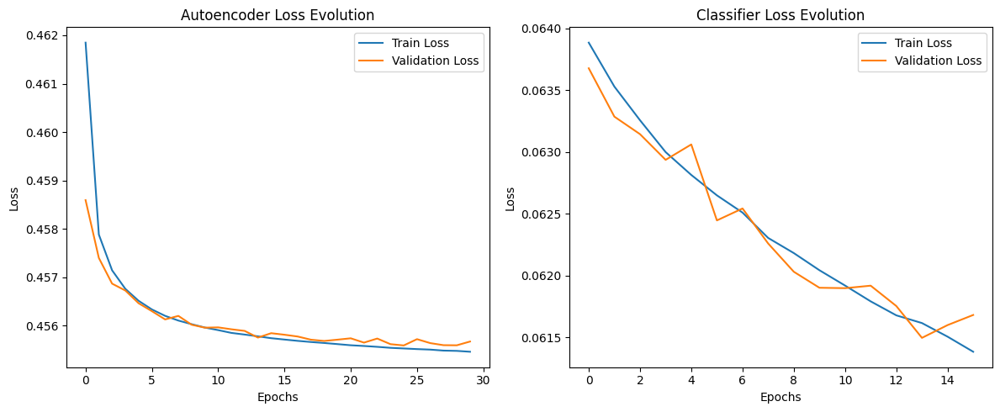

In [91]:
# Plot loss evolution
plot_training_history(autoencoder_history, classifier_history)

### Legacy code for training

In [8]:
## BUILD, TRAIN & VALIDATE DEEP AUTOENCODER
print('Building autoencoder model...')

def build_autoencoder(X):
    # encoded dimension
    encoded_dim = 164

    # number of features
    num_features = X.shape[1]

    # input placeholder
    input_img = Input(shape=(num_features,))
    # 'encoder' model
    encoded = Dense(512, activation='relu')(input_img)
    encoded = Dense(512, activation='relu')(encoded)
    encoded = Dense(256, activation='relu')(encoded)
    encoded = Dense(encoded_dim, activation='relu')(encoded)

    # 'decoder' model
    decoded = Dense(256, activation='relu')(encoded)
    decoded = Dense(512, activation='relu')(decoded)
    decoded = Dense(512, activation='relu')(decoded)
    decoded = Dense(num_features, activation='sigmoid')(decoded)

    # create seperate encoder
    encoder = Model(input_img, encoded)

    # full autoeconder model
    autoencoder = Model(input_img, decoded)

    # configure model to be trained
    # per-feature binary crossentropy loss
    autoencoder.compile(optimizer='Adam', loss='binary_crossentropy')

    return encoder, autoencoder

encoder, autoencoder = build_autoencoder(X)

# TODO - Change epochs from 2 to 20 (here) & from 2 to 10 (in the next cell). I lowered it for testing purposes
autoencoder.fit(X_train, X_train, 
                epochs=1, 
                batch_size=32, 
                shuffle=True,
                validation_data=(X_test, X_test))

## VALIDATE
print('Validating autoencoder model...')

from sklearn.metrics import r2_score
y_pred = autoencoder.predict(X_test)
varExpl = r2_score(X_test, y_pred,
            multioutput='variance_weighted')
print('Proportion of variance explained: ' + str(varExpl))

Building autoencoder model...


2025-02-24 14:54:15.208537: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


2665/2665 ━━━━━━━━━━━━━━━━━━━━ 64s 23ms/step - loss: 0.4659 - val_loss: 0.4575
Validating autoencoder model...
667/667 ━━━━━━━━━━━━━━━━━━━━ 3s 4ms/step
Proportion of variance explained: 0.6595474481582642


Training classifier model...
2665/2665 ━━━━━━━━━━━━━━━━━━━━ 42s 15ms/step - accuracy: 0.2575 - loss: 0.0776 - val_accuracy: 0.3241 - val_loss: 0.0643
Validating classifier model...
667/667 ━━━━━━━━━━━━━━━━━━━━ 4s 6ms/step


Text(0.5, 1.0, 'Jaccard index from thresholds of DNN output')

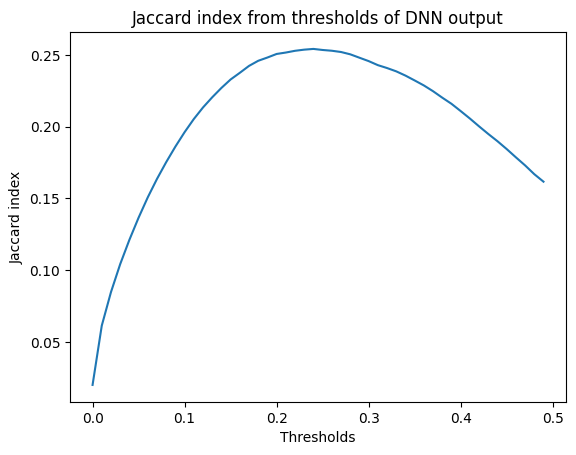

In [ ]:
## BUILD, TRAIN & VALIDATE CLASSIFIER
def build_classifier(feats, genres):
    # number of features and genres
    num_features = feats.shape[1]
    num_genres = genres.shape[1]

    x = encoder.output
    # add a classification layer
    x = Dense(1024, activation='relu')(x)
    x = Dropout(0.2)(x)
    predictions = Dense(num_genres, activation='sigmoid')(x)

    # this is the model we will train for classification
    model = Model(encoder.input, predictions)

    # first we need to freeze all encoder layers so they
    # are not trained by the classification process
    for layer in encoder.layers:
        layer.trainable = False

    # compile the model (should be done *after* setting layers to non-trainable)
    model.compile(optimizer='Adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])

    return model

model = build_classifier(X_train, y_train)

print('Training classifier model...')
model.fit(X_train, y_train,
          epochs=1,
          batch_size=32,
          shuffle=True,
          validation_data=(X_test, y_test))

In [ ]:
# SAVE THE FULL MODEL, EMBEDDING LAYER & INPUT NORMALISATION PARAMETERS 

# Save the full classifier model
model.save('models/FMA_full_model.keras')

# Extract the embedding layer (layer before the Dropout)
embedding_model = Model(inputs=model.input, outputs=model.get_layer(index=-3).output)  

# Save the embedding model
embedding_model.save('models/FMA_embedding_model.keras')

# Save the normalization parameters (dimMin & dimMax)
np.save('models/FMA_dimMin.npy', dimMin)
np.save('models/FMA_dimMax.npy', dimMax)

print("Embedding model, full model, and normalization parameters saved successfully.")

## Evaluate full model - genre classification evaluation
Only need to run "Setup". Runs independently of the other sections

In [14]:
# LOAD THE FULL MODEL, EMBEDDING MODEL & NORMALISATION PARAMETERS
model = load_model('models/FMA_full_model.keras')
embedding_model = load_model('models/FMA_embedding_model.keras')
dimMin = np.load('models/FMA_dimMin.npy')
dimMax = np.load('models/FMA_dimMax.npy')

 50/667 ━━━━━━━━━━━━━━━━━━━━ 3s 6ms/step

667/667 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step


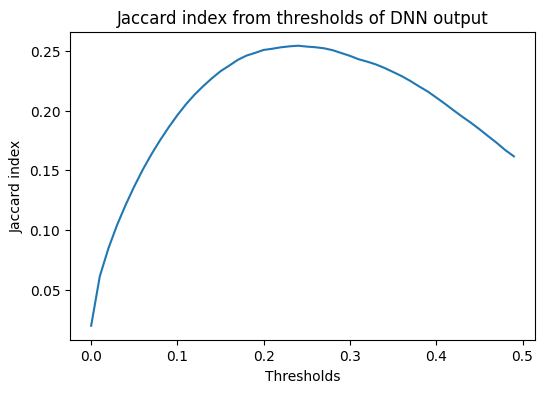

Optimal threshold: 0.24


Test labels:

,Avant-Garde,International,Blues,Jazz,Classical,Novelty,Comedy,Old-Time / Historic,Country,Pop,...,Salsa,Nu-Jazz,Hip-Hop Beats,Modern Jazz,Turkish,Tango,Fado,Christmas,Instrumental,no_genre
track_id,,,,,,,,,,,,,,,,,,,,,
43742,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31941,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Predicted labels:

,Avant-Garde,International,Blues,Jazz,Classical,Novelty,Comedy,Old-Time / Historic,Country,Pop,...,Salsa,Nu-Jazz,Hip-Hop Beats,Modern Jazz,Turkish,Tango,Fado,Christmas,Instrumental,no_genre
track_id,,,,,,,,,,,,,,,,,,,,,
43742,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
31941,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


Test set             Genres in dataframe: 160   Absent genres: 3
Predicted labels     Genres in dataframe: 47    Absent genres: 116


In [ ]:
# GET MODEL PREDICTIONS FOR TEST SET
def get_model_predictions(model, X_test, y_test, threshold_step=0.01, plot_jaccard=True):
    """Get model predictions."""
    # Get model predictions
    label_pred = model.predict(X_test)

    # Use Jaccard index to find optimal threshold
    threshs = np.arange(0, 0.5, threshold_step)
    jacIndxs = np.zeros(threshs.shape)
    for i, thresh in enumerate(threshs):
        thisJacIndx = jaccard_score(y_test, label_pred > thresh, average='samples')
        jacIndxs[i] = thisJacIndx
    optThresh = threshs[np.argmax(jacIndxs)]
    thresh_label_pred = label_pred > optThresh

    # Plot Jaccard index
    if plot_jaccard:
        # Start figure
        plt.figure(figsize=(6, 4))
        plt.plot(threshs, jacIndxs)
        plt.xlabel('Thresholds')
        plt.ylabel('Jaccard index')
        plt.title('Jaccard index from thresholds of DNN output')
        plt.show()

    # Show the optimal threshold
    print(f'Optimal threshold: {optThresh:.2f}')

    # Convert predictions into pandas DataFrame
    thresh_label_pred = pd.DataFrame(thresh_label_pred, columns=y_test.columns, index=y_test.index).astype(float)

    return thresh_label_pred, optThresh

thres_label_pred, optThresh = get_model_predictions(model, X_test, y_test)

def analyze_genre_coverage(y_test, id_to_genre, df_name='Test set'):
    genres_in_test = np.sum(y_test, axis=0) > 0
    present_genres = [genre for genre, present in zip(id_to_genre.values(), genres_in_test) if present]
    absent_genres = [genre for genre, present in zip(id_to_genre.values(), genres_in_test) if not present]

    print(f"{df_name:<20} Genres in dataframe: {len(present_genres):<5} Absent genres: {len(absent_genres)}")
    # print(f"Genres present in test set: {present_genres}")
    # print(f"Genres absent in test set: {absent_genres}")

# Display dataframes
md("Test labels:")
display(y_test.head(2))
md("Predicted labels:")
display(thres_label_pred.head(2))

# Analyze genre coverage
analyze_genre_coverage(y_test.values, id_to_genre, 'Test set')
analyze_genre_coverage(thres_label_pred.values, id_to_genre, 'Predicted labels')

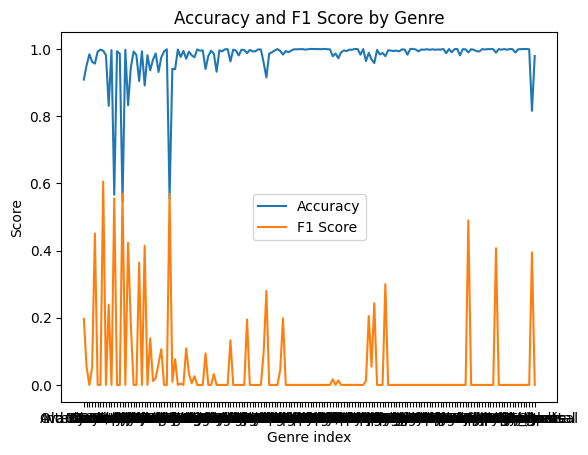

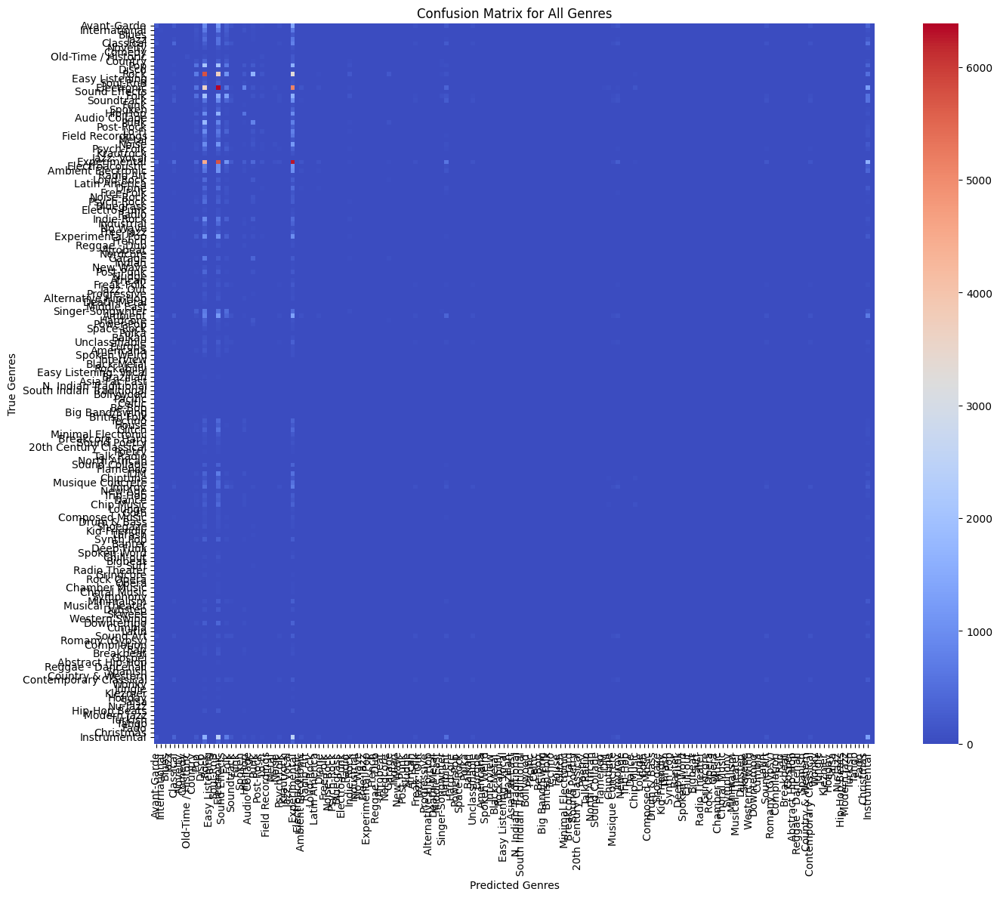

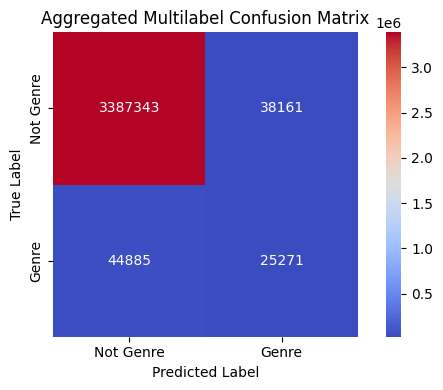

In [ ]:
# PLOT EVALUATION METRICS
from sklearn.metrics import jaccard_score, accuracy_score, precision_score, recall_score, f1_score, classification_report, confusion_matrix, multilabel_confusion_matrix
import seaborn as sns

# Function to compute evaluation metrics
def compute_metrics(y_test_df, pred_df):
    """Compute evaluation metrics for the model."""
    genrePres = precision_score(y_test_df, pred_df, average=None, zero_division=0)
    genreRecall = recall_score(y_test_df, pred_df, average=None, zero_division=0)
    genreF1 = f1_score(y_test_df, pred_df, average=None, zero_division=0)

    # Compute genre accuracy per genre
    isCorrect = (pred_df == y_test_df)
    genreAcc = np.sum(isCorrect, axis=0) / isCorrect.shape[0]

    # Compute aggregated confusion matrix
    multilabel_conf_matrix = multilabel_confusion_matrix(y_test_df.values, pred_df.values)

    # Compute full confusion matrix for all genres
    conf_matrix = np.dot(y_test_df.values.T, pred_df.values)
    return genreAcc, genreF1, genrePres, genreRecall, conf_matrix, multilabel_conf_matrix

def plot_confusion_matrix(conf_matrix, id_to_genre, multilabel_conf_matrix):
    """Plot the confusion matrix for all genres, along with an aggregated multilabel confusion matrix."""
    plt.figure(figsize=(15, 12))
    sns.heatmap(conf_matrix, annot=False, cmap='coolwarm', 
                xticklabels=list(id_to_genre.values()), 
                yticklabels=list(id_to_genre.values()),
                square=True)
    plt.xlabel('Predicted Genres')
    plt.ylabel('True Genres')
    plt.title('Confusion Matrix for All Genres')
    plt.xticks(rotation=90)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

    # Plot aggregated multilabel confusion matrix if provided
    plt.figure(figsize=(6, 4))
    sns.heatmap(multilabel_conf_matrix.sum(axis=0), annot=True, cmap='coolwarm',
                xticklabels=['Not Genre', 'Genre'],
                yticklabels=['Not Genre', 'Genre'],
                square=True, fmt='d')
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Aggregated Multilabel Confusion Matrix')
    plt.tight_layout()
    plt.show()

# Function to plot evaluation metrics
def plot_evaluation_metrics(genreAcc, genreF1, conf_matrix, multilabel_conf_matrix, id_to_genre):
    # Plot Accuracy and F1 Score
    plt.figure()
    plt.plot(genreAcc, label='Accuracy')
    plt.plot(genreF1, label='F1 Score')
    plt.xlabel('Genre index')
    plt.ylabel('Score')
    plt.title('Accuracy and F1 Score by Genre')
    plt.legend()
    plt.show()
    
    # Plot confusion matrix
    plot_confusion_matrix(conf_matrix, id_to_genre, multilabel_conf_matrix)

# Example usage
# Assuming thres_label_pred and y_test are dataframes with the same structure
genreAcc, genreF1, genrePres, genreRecall, conf_matrix, multilabel_conf_matrix = compute_metrics(y_test, thres_label_pred)
plot_evaluation_metrics(genreAcc, genreF1, conf_matrix, multilabel_conf_matrix, id_to_genre)


Validating classifier model...
667/667 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step


Text(0.5, 1.0, 'Jaccard index from thresholds of DNN output')

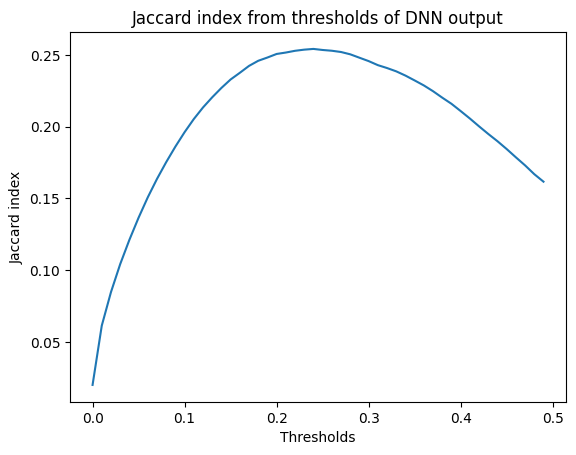

In [15]:
# Validate classifier
print('Validating classifier model...')
label_pred = model.predict(X_test)
threshs = np.arange(0, 0.5, 0.01)
jacIndxs = np.zeros(threshs.shape)
for i,thresh in enumerate(threshs):
    thisJacIndx = jaccard_score(y_test, label_pred > thresh, average='samples')
    jacIndxs[i] = thisJacIndx

plt.plot(threshs, jacIndxs)
plt.xlabel('Thresholds')
plt.ylabel('Jaccard index')
plt.title('Jaccard index from thresholds of DNN output')

In [17]:
# calculate accuracy, precision, and recall
optThresh = threshs[np.argmax(jacIndxs)]
thresh_label_pred = label_pred > optThresh

# Per-genre metrics
genrePres = precision_score(y_test, thresh_label_pred, average=None, zero_division=0)
genreRecall = recall_score(y_test, thresh_label_pred, average=None, zero_division=0)
genreF1 = f1_score(y_test, thresh_label_pred, average=None, zero_division=0)

# For accuracy per genre, you can calculate it manually
isCorrect = (thresh_label_pred == y_test)
genreAcc = np.sum(isCorrect, axis=0) / isCorrect.shape[0]

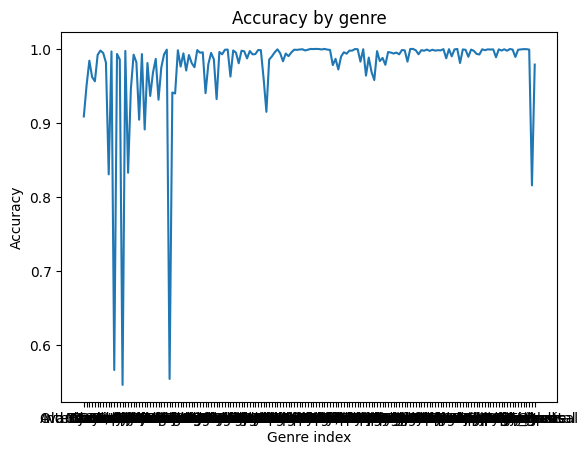

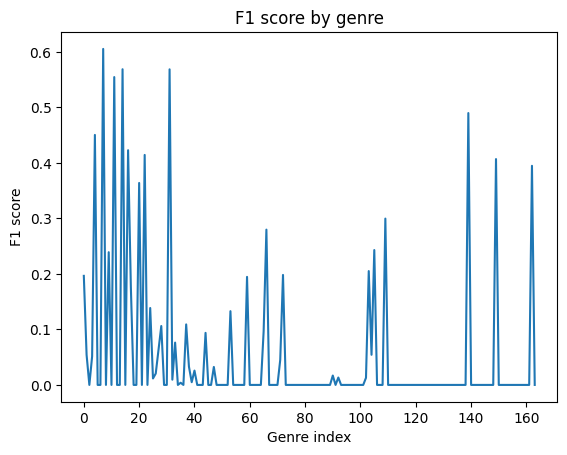

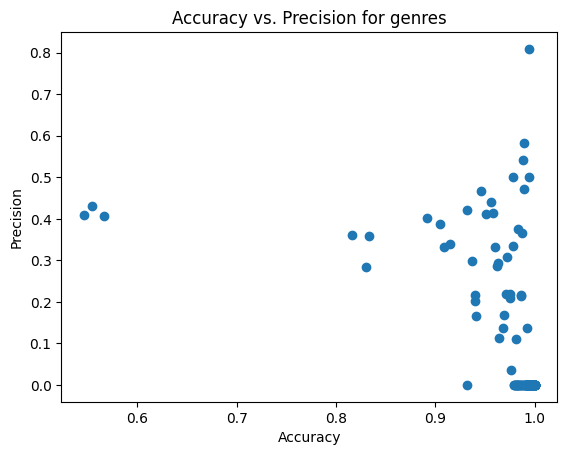

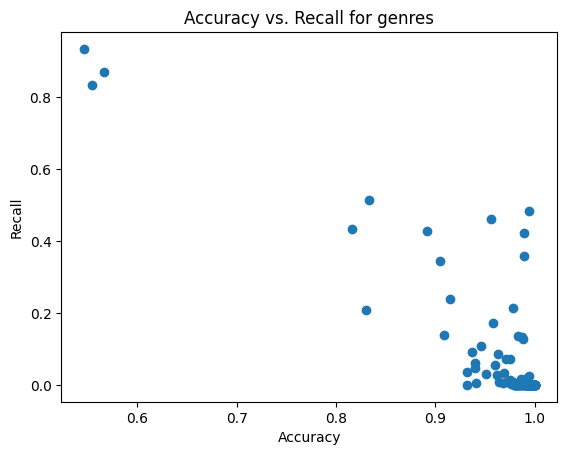

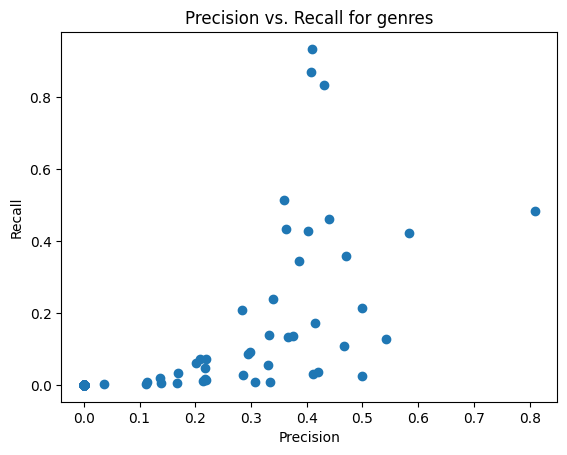

In [18]:
# PLOT CLASSIFICATION METRICS
# plot accuracy
plt.plot(genreAcc)
plt.xlabel('Genre index')
plt.ylabel('Accuracy')
plt.title('Accuracy by genre')
plt.show()

# plot F1 score
plt.plot(genreF1)
plt.xlabel('Genre index')
plt.ylabel('F1 score')
plt.title('F1 score by genre')
plt.show()

# get genres with less than 90% accuracy
# accLess90 = np.where(genreAcc < 0.9)
# less90List = []
# less90Acc = []
# for index in accLess90[0]:
#     thisGenre = id_to_genre[index]
#     less90List.append(thisGenre)
#     less90Acc.append(genreAcc[index])
# plt.bar(less90List, less90Acc)
# plt.xlabel('Genre')
# plt.ylabel('Accuracy')
# plt.xticks(rotation=20)
# plt.title('Genres with less than 90% accuracy')
# plt.show()

# plot accuracy vs precision
plt.scatter(genreAcc, genrePres)
plt.xlabel('Accuracy')
plt.ylabel('Precision')
plt.title('Accuracy vs. Precision for genres')
plt.show()

# plot accuracy vs recall
plt.scatter(genreAcc, genreRecall)
plt.xlabel('Accuracy')
plt.ylabel('Recall')
plt.title('Accuracy vs. Recall for genres')
plt.show()

# plot precision vs recall
plt.scatter(genrePres, genreRecall)
plt.xlabel('Precision')
plt.ylabel('Recall')
plt.title('Precision vs. Recall for genres')
plt.show()

In [19]:
# SAVE THE EMBEDDING LAYER & NORMALISATION PARAMETERS

# TODO - Uncomment if I want to save a better model. Also, I should save the whole model and its embeddings. Else, I have to retrain the model for any evaluation on it
# # Extract the embedding layer
# embedding_model = Model(inputs=model.input, outputs=model.get_layer(index=-3).output)  # -3 refers to the layer before the Dropout

# # Save the embedding model
# embedding_model.save('models/FMA_embedding_model.keras')

# # Save the dimMin & dimMax
# np.save('models/FMA_dimMin.npy', dimMin)
# np.save('models/FMA_dimMax.npy', dimMax)

## Obtain dictionary of similar song within the FMA dataset
Only need to run "Setup". Runs independently of the other sections

In [16]:
# LOAD THE EMBEDDING MODEL & NORMALISATION PARAMETERS
embedding_model = load_model('models/FMA_embedding_model.keras')
dimMin = np.load('models/FMA_dimMin.npy')
dimMax = np.load('models/FMA_dimMax.npy')

2025-02-19 12:58:30.120419: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)


In [17]:
# GET EMBEDDINGS FOR ALL SONGS IN THE FMA DATASET
def normalize_new_song_features(new_song_features, dimMin, dimMax):
    '''Uses the max and min obtained from normalised the train dataset to normalise new features'''
    dimRange = dimMax - dimMin
    norm_features = (new_song_features - dimMin) / dimRange
    return norm_features

# Normalise the features using the same parameters as the training data
FMA_eatures_norm = normalize_new_song_features(FMA_features, dimMin, dimMax)

# Get embeddings for all FMA songs
FMA_embeddings = embedding_model.predict(FMA_eatures_norm)

3331/3331 ━━━━━━━━━━━━━━━━━━━━ 18s 5ms/step


In [ ]:
# COMPUTE SIMILARITY MATRIX
def compute_top_k_similarities(embeddings, song_ids, top_k=10, batch_size=2000):
    """
    Computes the top K most similar songs for each song in a memory-efficient way.

    Args:
    - embeddings (np.ndarray): 2D NumPy array of shape (num_songs, embedding_dim).
    - song_ids (list): List of song IDs corresponding to each row in embeddings.
    - top_k (int): Number of most similar songs to store per song.
    - batch_size (int): Number of rows to process at a time to avoid memory overflow.

    Returns:
    - dict: {song_id: [(similar_song_id, similarity_score), ...]}
    """
    num_songs = embeddings.shape[0]
    similarity_dict = {}

    for start in range(0, num_songs, batch_size):
        end = min(start + batch_size, num_songs)
        batch_embeddings = embeddings[start:end]  # Process batch
        similarity_scores = cosine_similarity(batch_embeddings, embeddings)  # Compute similarity
        
        for i, row in enumerate(similarity_scores):
            song_index = start + i  # Actual song index in full dataset
            
            # Get top K similar songs (excluding self)
            top_indices = np.argsort(row)[::-1][1:top_k+1]  # Sort & remove self-match
            top_similar = [(song_ids[idx], row[idx]) for idx in top_indices]

            similarity_dict[song_ids[song_index]] = top_similar  # Store results

        print(f"Processed {end}/{num_songs} songs...\r")  # Progress update

    return similarity_dict

# Get song IDs
song_ids = FMA_features.index

# Compute similarity matrix
similarity_dict = compute_top_k_similarities(FMA_embeddings, song_ids, top_k=10)

# Convert from numpy to float
similarity_dict = {int(k): [(int(id), float(score)) for id, score in l] for k, l in similarity_dict.items()}

# Save the similarity matrix
with open(paths.FMA_SIMILARITY_DICT, 'w') as f:
    json.dump(similarity_dict, f)

Processed 2000/106574 songs...
Processed 4000/106574 songs...
Processed 6000/106574 songs...
Processed 8000/106574 songs...
Processed 10000/106574 songs...
Processed 12000/106574 songs...
Processed 14000/106574 songs...
Processed 16000/106574 songs...
Processed 18000/106574 songs...
Processed 20000/106574 songs...
Processed 22000/106574 songs...
Processed 24000/106574 songs...
Processed 26000/106574 songs...
Processed 28000/106574 songs...
Processed 30000/106574 songs...
Processed 32000/106574 songs...
Processed 34000/106574 songs...
Processed 36000/106574 songs...
Processed 38000/106574 songs...
Processed 40000/106574 songs...
Processed 42000/106574 songs...
Processed 44000/106574 songs...
Processed 46000/106574 songs...
Processed 48000/106574 songs...
Processed 50000/106574 songs...
Processed 52000/106574 songs...
Processed 54000/106574 songs...
Processed 56000/106574 songs...
Processed 58000/106574 songs...
Processed 60000/106574 songs...
Processed 62000/106574 songs...
Processed 64

## Subjective evaluation of FMA Similarity Module

The similarity module will be evaluated subjectively by randomly selecting 1 song representative of each of the [num genres] genres, and checking whether its top 5 similar songs are similar.

In [129]:
# START BY ONLY CHECKING 16 SONGS: 1 SONG REPRESENTATIVE OF EACH OF THE PARENT GENRES

# # Load the similarity matrix
# with open(paths.FMA_SIMILARITY_DICT, 'r') as f:
#     similarity_dict = json.load(f)

# Get the parent genres
parent_genres = FMA_genres[FMA_genres['parent'] == 0]['title']

# Filter tracks to include only those with genre_top in parent genres
filtered_tracks = FMA_tracks[FMA_tracks[('track', 'genre_top')].isin(parent_genres)]

# Get one random track per genre_top
random_tracks = filtered_tracks.groupby(('track', 'genre_top'), observed=True).apply(lambda x: x.sample(1), include_groups = False)
random_track_ids = random_tracks.reset_index()['track_id']

In [144]:
import librosa
import IPython.display as ipd
import os

def get_audio_path(audio_dir, track_id):
    """
    Return the path to the mp3 given the directory where the audio is stored
    and the track ID.
    """
    tid_str = '{:06d}'.format(track_id)
    return os.path.join(audio_dir, tid_str[:3], tid_str + '.mp3')

def play_song(audio_dir, track_id, start=5, end=25):
    """
    Play a snippet of the audio file for the given track ID.
    """
    filename = get_audio_path(audio_dir, track_id)
    x, sr = librosa.load(filename, sr=None, mono=True)
    display(ipd.Audio(data=x[start*sr:end*sr], rate=sr))

def play_similar_tracks(random_track_ids, similarity_dict, audio_dir, top_k=5):
    """
    For each random track, play the original song followed by the top k most similar songs.
    """
    for track_id in random_track_ids:
        print(f"Playing original track ID: {track_id}")
        play_song(audio_dir, track_id)
        
        print(f"Playing top {top_k} most similar songs:")
        most_similar_tracks = similarity_dict[str(track_id)][:top_k]
        
        for similar_track_id, _ in most_similar_tracks:

            play_song(audio_dir, similar_track_id)
        print("\n")

def show_similar_tracks_names(random_track_ids, similarity_dict, audio_dir, top_k=5):
    """
    For each random track, play the original song followed by the top k most similar songs.
    """
    for track_id in random_track_ids:
        print(f"Original track: {track_id} | {FMA_tracks.loc[track_id]['track']['title']} | {FMA_tracks.loc[track_id]['artist']['name']} | {FMA_tracks.loc[track_id]['album']['title']}")
        print(f"Top {top_k} most similar songs:")
        most_similar_tracks = similarity_dict[str(track_id)][:top_k]

        for similar_track_id, _ in most_similar_tracks:
            print(f"\t{similar_track_id} | {FMA_tracks.loc[similar_track_id]['track']['title']} | {FMA_tracks.loc[similar_track_id]['artist']['name']} | {FMA_tracks.loc[similar_track_id]['album']['title']}")

            # Uncomment to get song snippet
        print("\n")

# Example usage
show_similar_tracks_names(random_track_ids, similarity_dict, paths.FMA_SMALL_D, top_k=5)

Original track: 3427 | Bittersweet | Brother JT | Live at WFMU on Brian Turner's Show on 5/14/2002
Top 5 most similar songs:
	3429 | Had To Be | Brother JT | Live at WFMU on Brian Turner's Show on 5/14/2002
	3428 | Now and Then | Brother JT | Live at WFMU on Brian Turner's Show on 5/14/2002
	3430 | Child of the Sun | Brother JT | Live at WFMU on Brian Turner's Show on 5/14/2002
	83300 | B08 I'm Wild | Better Psychics | Better Psychics
	64874 | Faithful Kind | Luke Roberts | Live at WFMU on Shrunken Planet with Jeffrey Davison May 5th 2012


Original track: 75711 | Gnossienne 5 | Chad Crouch | Vol 4: Satie: Rearranged Furniture Music
Top 5 most similar songs:
	122902 | Dias | Hicham Chahidi | Moments
	50951 | J. S. Bach: Prelude in C - BWV 846 | Kevin MacLeod | Classical Sampler
	65682 | Aria | Kimiko Ishizaka | The Open Goldberg Variations
	81453 | Detroit | Podington Bear | Solo Instruments
	81450 | Colorado | Podington Bear | Solo Instruments


Original track: 14018 | Get Me A Job | 

In [ ]:
def show_similar_trackids(random_track_ids, similarity_dict, audio_dir, top_k=5):
    """
    For each random track, play the original song followed by the top k most similar songs.
    """

    for track_id in random_track_ids:

        print(track_id)
        most_similar_tracks = similarity_dict[str(track_id)][:top_k]
        for similar_track_id, _ in most_similar_tracks:
            print(similar_track_id)

        print("\n")

show_similar_trackids(random_track_ids, similarity_dict, paths.FMA_SMALL_D, top_k=5)

In [ ]:
# TRY OUT THE SIMILARITY FUNCTION
import librosa
import IPython.display as ipd

def get_audio_path(audio_dir, track_id):
    """
    Return the path to the mp3 given the directory where the audio is stored
    and the track ID.

    Examples
    --------
    >>> import utils
    >>> AUDIO_DIR = os.environ.get('AUDIO_DIR')
    >>> utils.get_audio_path(AUDIO_DIR, 2)
    '../data/fma_small/000/000002.mp3'

    """
    tid_str = '{:06d}'.format(track_id)
    return os.path.join(audio_dir, tid_str[:3], tid_str + '.mp3')

def play_song(AUDIO_DIR, song_idx):
    filename = get_audio_path(AUDIO_DIR, int(song_idx))

    x, sr = librosa.load(filename, sr=None, mono=True)
    start, end = 5, 25
    display(ipd.Audio(data=x[start*sr:end*sr], rate=sr))

# Get genre mappings
genre_to_id, id_to_genre, id_to_idx = get_genre_mappings(FMA_genres)

# Try it out 5 times
for i in range(4):
    # Get a random index
    idx = np.random.randint(0, len(FMA_small_features_norm))
    song_id = FMA_small_features_norm.index[idx]
    
    # Play the query song
    print(f'Query song: {song_id}')
    print(f'{FMA_tracks.loc[song_id]["track"]["title"]} | {FMA_tracks.loc[song_id]["album"]["title"]}')
    print(f"Genres: {[id_to_genre[id] for id in FMA_tracks.loc[song_id]["track"]['genres_all']]}")
    play_song(paths.FMA_SMALL_D, song_id)

    # Find the 3 most similar songs to that index
    query_embedding = FMA_small_embeddings[idx]
    most_similar = find_most_similar(query_embedding, FMA_small_embeddings, FMA_small_features_norm.index, top_k=3)

    # Play those songs
    print('Similar songs:')
    for song_id, similarity in most_similar:
        print(f'Song ID: {song_id}')
        print(f'{FMA_tracks.loc[song_id]["track"]["title"]} | {FMA_tracks.loc[song_id]["album"]["title"]}')
        print(f"Genres: {[id_to_genre[id] for id in FMA_tracks.loc[song_id]["track"]['genres_all']]}")
        print('Similarity: {:.2f}'.format(similarity))
        play_song(paths.FMA_SMALL_D, song_id)
    print('\n')

Query song: 144934
Off | Fridays, Volume 1
Genres: ['Pop']


Similar songs:
Song ID: 47196
Come on Devil | Awott
Genres: ['Experimental']
Similarity: 0.80


Song ID: 127298
Lovedreams | New brave face
Genres: ['Pop']
Similarity: 0.78


Song ID: 129407
Mandingo Tribe | Live at Monty Hall with Jeff Sarge of Reggae Schoolroom, 10/03/2015
Genres: ['Reggae - Dancehall', 'International', 'Reggae - Dub']
Similarity: 0.77




Query song: 73370
Tunnel Vision | Solar Phases
Genres: ['Ambient Electronic', 'Downtempo', 'Electronic']


Similar songs:
Song ID: 55715
Chain splendour 2 | The agency of missing hearts
Genres: ['Post-Rock', 'Rock']
Similarity: 0.87


Song ID: 42372
Only Instrumental | Directionless EP
Genres: ['Minimal Electronic', 'Electronic']
Similarity: 0.86


Song ID: 98203
A Message From Space | Prometheus
Genres: ['Dance', 'Techno', 'Electronic']
Similarity: 0.84




Query song: 42377
Night Owl | Directionless EP
Genres: ['Minimal Electronic', 'Electronic']


Similar songs:
Song ID: 42375
Day Bird | Directionless EP
Genres: ['Minimal Electronic', 'Electronic']
Similarity: 0.78


Song ID: 69830
Higher (Instrumental) | Higher
Genres: ['Hip-Hop']
Similarity: 0.77


Song ID: 100835
little scary movie | Along The Way
Genres: ['Ambient Electronic', 'IDM', 'Electronic']
Similarity: 0.76




Query song: 54476
Nuf a dem suffering | Life is inna riddim
Genres: ['International', 'Reggae - Dub']


Similar songs:
Song ID: 87068
One More Reason (unofficial SFI remix) | Realm of the New Day - The Remixes
Genres: ['Drum & Bass', 'Ambient Electronic', 'Electronic']
Similarity: 0.88


Song ID: 114245
Lavanda (We Are Not Dj's Nu Disco Remix) | Dance
Genres: ['Electronic']
Similarity: 0.83


Song ID: 91306
NY Don't Sleep (Luckstrumental) | Master Don
Genres: ['Hip-Hop']
Similarity: 0.83


### Make dictionary smaller

In [21]:
!ls ../match-api/data/stored_data

FMA_similarity_dict.json  dataframes.h5  inverted_index.pkl


In [22]:
# Save the similarity matrix
with open('../match-api/data/stored_data/FMA_similarity_dict.json', 'r') as f:
    
    similarity_dict = json.load(f)

similarity_dict

JSONDecodeError: Expecting value: line 1 column 1 (char 0)